In [77]:
import pandas as pd
import matplotlib.pyplot as plt
from scipy import stats
import numpy as np
from globals import BASE_DIR
import json
dataset = "snowcard"
available_datasets = ["yelp"]

DATASET_DIR = f"{BASE_DIR}{dataset}_dataset/"



In [78]:
def group_user_events(user_events, user_groups):
    stats = {}
    for group in user_groups.keys():
        stats[group] = {}
        user_events_group = user_events.copy()
        user_events_group = user_events_group.loc[user_events_group['user_id:token'].isin(user_groups[group])]
        user_dist = user_events_group["user_id:token"].value_counts()
        stats[group]["num_users"] = user_dist.shape[0]
        stats[group]["mean_checkins"] = user_events_group["user_id:token"].value_counts().mean()
        stats[group]["min_checkins"] = user_events_group["user_id:token"].value_counts().min()
        stats[group]["max_checkins"] = user_events_group["user_id:token"].value_counts().max()
        item_dist = user_events_group["item_id:token"].value_counts()
        stats[group]["num_items"] = item_dist.shape[0]
        stats[group]["sparsity"] = 1 - len(user_events_group) / (len(user_events_group["user_id:token"].unique()) * len(user_events_group["item_id:token"].unique()))

    return stats



In [82]:
full_stats = {}
for dataset in available_datasets:
    # Stays the same across all models 
    train_data = pd.read_csv(f"{BASE_DIR}{dataset}_dataset/processed_data_recbole/{dataset}_sample.train.inter", sep="\t")
    test_data = pd.read_csv(f"{BASE_DIR}{dataset}_dataset/processed_data_recbole/{dataset}_sample.test.inter", sep="\t")
    valid_data = pd.read_csv(f"{BASE_DIR}{dataset}_dataset/processed_data_recbole/{dataset}_sample.valid.inter", sep="\t")

    # user_group_dir = f"{BASE_DIR}{dataset}_dataset/{dataset}_user_id_popularity.json"
    # with open(user_group_dir) as f:
    #     user_groups = json.load(f)


    # all_user_ids = (
    # set(user_groups["high"])
    # | set(user_groups["medium"])
    # | set(user_groups["low"])
    # )
    # user_groups["all"] = list(all_user_ids)
    user_events = pd.concat([train_data, valid_data, test_data])
    user_events = user_events.drop_duplicates(subset=["user_id:token", "item_id:token"])

    #full_stats[dataset] = group_user_events(user_events, user_groups)

#full_stats = pd.DataFrame(full_stats).T.unstack("dataset")


# Convert `full_stats` dictionary into a long-format DataFrame
long_format_df = []

for dataset, group_stats in full_stats.items():
    for group, metrics in group_stats.items():
        row = {'dataset': dataset, 'group': group}
        row.update(metrics)  # Add all metrics as columns
        long_format_df.append(row)

# Create a DataFrame
long_format_df = pd.DataFrame(long_format_df)

# Display the resulting DataFrame
long_format_df


""


In [80]:
user_events

,user_id:token,item_id:token,checkin_count:float
0,0_x,0_x,1
1,0_x,451_x,1
2,0_x,569_x,1
3,0_x,1810_x,1
4,0_x,311_x,1
...,...,...,...
7628,9_x,979_x,1
7629,9_x,65_x,1
7630,9_x,2087_x,1
7631,9_x,4440_x,1


In [81]:
train_data.shape[0] + test_data.shape[0] + valid_data.shape[0]

35288

In [59]:
len(set(train_data["user_id:token"].values.tolist()))

600

In [60]:
dataset ="gowalla"

train_data = pd.read_csv(f"{BASE_DIR}{dataset}_dataset/processed_data_recbole/{dataset}_sample.train.inter", sep="\t")
test_data = pd.read_csv(f"{BASE_DIR}{dataset}_dataset/processed_data_recbole/{dataset}_sample.test.inter", sep="\t")
valid_data = pd.read_csv(f"{BASE_DIR}{dataset}_dataset/processed_data_recbole/{dataset}_sample.valid.inter", sep="\t")

In [61]:
train_data_user = train_data.loc[train_data["user_id:token"] == "1101_x"]["item_id:token"].values.tolist()


bpr_recs = [
            "2679_x",
            "1535_x",
            "2426_x",
            "2427_x",
            "2337_x",
            "2943_x",
            "2077_x",
            "1965_x",
            "3495_x",
            "2585_x"]



cp_min_js_recs = [ 
        "2679_x",
        "1535_x",
        "2426_x",
        "2427_x",
        "3288_x",
        "2337_x",
        "2943_x",
        "2077_x",
        "1091_x",
        "1484_x"]


lore_recs =[
            "4576_x",
            "3758_x",
            "1969_x",
            "4567_x",
            "5136_x",
            "4533_x",
            "4575_x",
            "3229_x",
            "3747_x",
            "1484_x"]

In [62]:
train_data_user

['4648_x',
 '4386_x',
 '1962_x',
 '1960_x',
 '2338_x',
 '1304_x',
 '3383_x',
 '2034_x',
 '1954_x',
 '1955_x',
 '4566_x',
 '3759_x',
 '1972_x',
 '1968_x',
 '4803_x',
 '211_x',
 '3964_x',
 '1922_x',
 '3802_x',
 '6791_x',
 '2827_x',
 '1971_x',
 '3753_x',
 '1438_x']

In [63]:
poi_data = pd.read_csv(f"{BASE_DIR}{dataset}_dataset/processed_data_capri/poiCoos.txt", sep="\t", header=None, names=["item_id:token", "lat:float", "lon:float"])

In [64]:
poi_data["item_id:token"] = poi_data["item_id:token"].astype(str) + "_x" 

In [65]:
train_poi_data = poi_data.loc[poi_data["item_id:token"].isin(train_data_user)]
bpr_poi_data = poi_data.loc[poi_data["item_id:token"].isin(bpr_recs)]
cp_poi_data = poi_data.loc[poi_data["item_id:token"].isin(cp_min_js_recs)]
lore_poi_data = poi_data.loc[poi_data["item_id:token"].isin(lore_recs)]

In [66]:
train_poi_data

,item_id:token,lat:float,lon:float
1800,1960_x,51.508008,-0.099328
1801,4566_x,51.503347,-0.127780
2198,3383_x,51.500982,-0.125002
3341,1955_x,51.499233,-0.125045
3473,1304_x,51.464542,-0.170546
3474,211_x,51.505497,-0.086920
4472,4386_x,51.508302,-0.108469
4474,2034_x,51.500759,-0.124594
4475,2338_x,51.502599,-0.113232
4476,1954_x,51.499319,-0.127448


In [67]:
import folium

map_center = [poi_data["lat:float"].mean(), poi_data["lon:float"].mean()]  # Center the map on average coordinates
poi_map = folium.Map(location=map_center, zoom_start=12)

# Add markers for BPR POIs (blue)

# Add markers for BPR POIs (blue)
for _, row in train_poi_data.iterrows():
    folium.Marker(
        location=[row["lat:float"], row["lon:float"]],
        popup=f"training data POI ID: {row['item_id:token']}",
        tooltip=f"Click for training POI {row['item_id:token']}",
        icon=folium.Icon(color="purple", icon="star")
    ).add_to(poi_map)

for _, row in bpr_poi_data.iterrows():
    folium.Marker(
        location=[row["lat:float"], row["lon:float"]],
        popup=f"BPR POI ID: {row['item_id:token']}",
        tooltip=f"Click for BPR POI {row['item_id:token']}",
        icon=folium.Icon(color="blue", icon="info-sign")
    ).add_to(poi_map)

# Add markers for CP POIs (red)
for _, row in cp_poi_data.iterrows():
    folium.Marker(
        location=[row["lat:float"], row["lon:float"]],
        popup=f"CP POI ID: {row['item_id:token']}",
        tooltip=f"Click for CP POI {row['item_id:token']}",
        icon=folium.Icon(color="red", icon="1")
    ).add_to(poi_map)

# Add markers for LORE POIs (green)
for _, row in lore_poi_data.iterrows():
    folium.Marker(
        location=[row["lat:float"], row["lon:float"]],
        popup=f"LORE POI ID: {row['item_id:token']}",
        tooltip=f"Click for LORE POI {row['item_id:token']}",
        icon=folium.Icon(color="green", icon="glyphicon-hourglass")
    ).add_to(poi_map)

# Save the map to an HTML file
poi_map.save("multiple_poi_map.html")
poi_map

In [68]:
full_stats

{'brightkite': {'high': {'num_users': 120,
   'mean_checkins': 19.583333333333332,
   'min_checkins': 15,
   'max_checkins': 36,
   'num_items': 581,
   'sparsity': 0.9662937464142284},
  'medium': {'num_users': 360,
   'mean_checkins': 26.169444444444444,
   'min_checkins': 15,
   'max_checkins': 97,
   'num_items': 792,
   'sparsity': 0.9669577721661055},
  'low': {'num_users': 120,
   'mean_checkins': 29.75,
   'min_checkins': 15,
   'max_checkins': 105,
   'num_items': 747,
   'sparsity': 0.9601740294511378},
  'all': {'num_users': 600,
   'mean_checkins': 25.56833333333333,
   'min_checkins': 15,
   'max_checkins': 105,
   'num_items': 794,
   'sparsity': 0.9677980688497061}}}

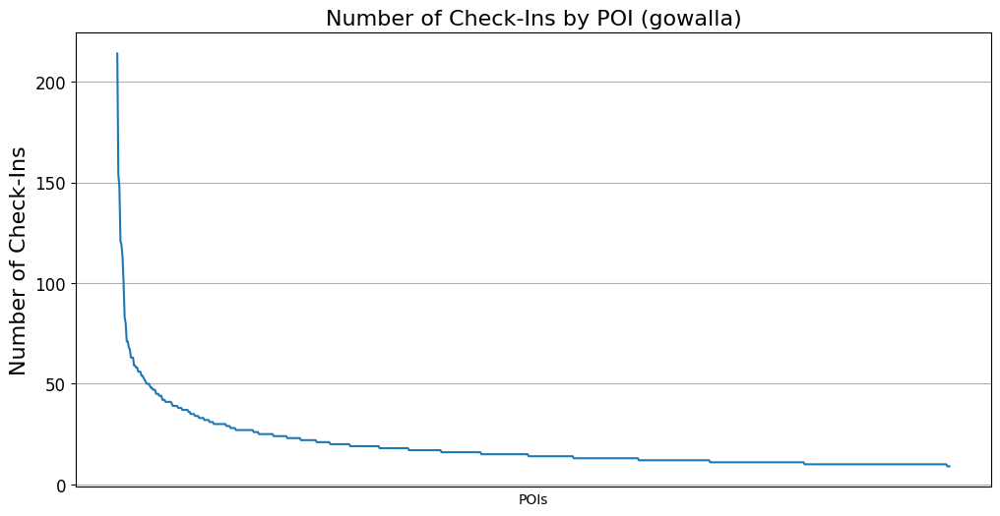

In [69]:
user_events["item_id:token"].astype(str).value_counts().plot(figsize=(12, 6), linestyle='-')
plt.xlabel('POIs')
plt.title(f'Number of Check-Ins by POI ({dataset})', fontsize=16)
plt.ylabel('Number of Check-Ins', fontsize=16)
plt.grid(True)

plt.xticks([])

plt.yticks(fontsize=12)  



plt.savefig(f'{DATASET_DIR}/plots/Number of Check-Ins by POI ({dataset})', dpi=300)


In [70]:
import pandas as pd
import folium
from folium.plugins import MarkerCluster

# Define your datasets
available_datasets = ["snowcard", "gowalla", "yelp", "foursquaretky", "brightkite"]
base_dir = "BASE_DIR"

# Define colors for each dataset
colors = ['red', 'blue', 'green', 'orange', 'purple']

# Create a base map centered at a default location (adjust to your data's center)
map_center = [39.95, -75.16]  # Example: Center near Philadelphia
poi_map = folium.Map(location=map_center, zoom_start=5)

# Add points from each dataset
for dataset, color in zip(available_datasets, colors):
    # Load the POI data
    file_path = DATASET_DIR = f"{BASE_DIR}{dataset}_dataset/processed_data_capri/poiCoos.txt"
    poi_data = pd.read_csv(file_path, sep="\t", header=None, names=["id", "lat:float", "lon:float"])
    
    # Create a MarkerCluster for better visualization of overlapping points
    marker_cluster = MarkerCluster(name=dataset).add_to(poi_map)
    
    # Add each POI to the map
    for _, row in poi_data.iterrows():
        folium.CircleMarker(
            location=[row["lat:float"], row["lon:float"]],
            radius=5,
            color=color,
            fill=True,
            fill_color=color,
            fill_opacity=0.7,
            popup=f"ID: {row['id']}, Dataset: {dataset}"
        ).add_to(marker_cluster)

# Add a layer control to toggle datasets on/off
folium.LayerControl().add_to(poi_map)

# Save or display the map
poi_map.save("poi_map.html")
poi_map




# FeatureGroupSubGroup
# https://python-visualization.github.io/folium/latest/user_guide/plugins/featuregroup_subgroup.html


# GroupedLayerControl
# https://python-visualization.github.io/folium/latest/user_guide/plugins/grouped_layer_control.html


#TagFilterButton
# https://python-visualization.github.io/folium/latest/user_guide/plugins/tag_filter_button.html

#TreeLayerControl
# https://python-visualization.github.io/folium/latest/user_guide/plugins/treelayercontrol.html



In [71]:
# user distribution
user_dist = user_events["user_id:token"].value_counts()
num_users = user_dist.shape[0]
print("Mean (different) POI check-ins per User: ", user_events["user_id:token"].value_counts().mean())
print("Min (different) POI check-ins per User: ", user_events["user_id:token"].value_counts().min())
print("Max (different) POI check-ins per User: ", user_events["user_id:token"].value_counts().max())
print("Number of users: ", num_users)

# item distribution
item_dist = user_events["item_id:token"].value_counts()
num_items = item_dist.shape[0]
print("Number of POIs (items): ", num_items)

# sparsity
print("Sparsity:", 1 - len(user_events) / (len(user_events["user_id:token"].unique()) * len(user_events["item_id:token"].unique())))


Mean (different) POI check-ins per User:  25.56833333333333
Min (different) POI check-ins per User:  15
Max (different) POI check-ins per User:  105
Number of users:  600
Number of POIs (items):  794
Sparsity: 0.9677980688497061


In [72]:
print(dataset)
stats = group_user_events(user_events, user_groups)



brightkite


In [73]:
pd.DataFrame(stats).T

,num_users,mean_checkins,min_checkins,max_checkins,num_items,sparsity
high,120.0,19.583333,15.0,36.0,581.0,0.966294
medium,360.0,26.169444,15.0,97.0,792.0,0.966958
low,120.0,29.750000,15.0,105.0,747.0,0.960174
all,600.0,25.568333,15.0,105.0,794.0,0.967798


In [74]:
len(user_events["user_id:token"].unique())

600

In [75]:
user_events["item_id:token"].value_counts()

item_id:token
0_x      214
428_x    154
20_x     148
396_x    121
400_x    119
        ... 
700_x     10
426_x     10
181_x      9
710_x      9
195_x      9
Name: count, Length: 794, dtype: int64

NotADirectoryError: [Errno 20] Not a directory: '/Volumes/Forster Neu/Masterarbeit Data/brightkite_dataset/processed_data_capri/poiCoos.txt/plots/Long-tail of Check-Ins (brightkite).png'

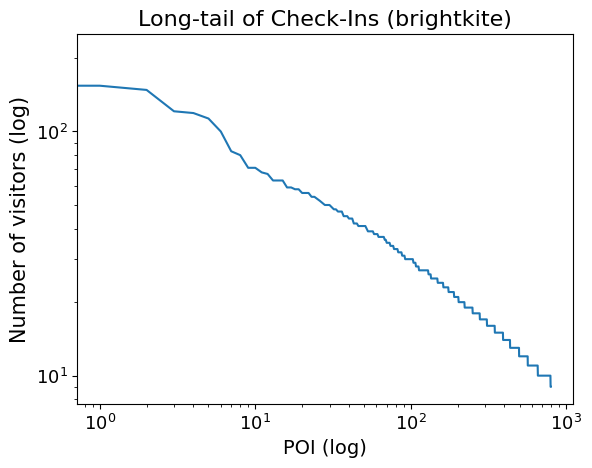

In [76]:
# plot item distribution
plt.figure()
plt.plot(item_dist.values, linestyle='-')
plt.title(f'Long-tail of Check-Ins ({dataset})', fontsize=16)
plt.xlabel('POI (log)', fontsize=14)
plt.ylabel('Number of visitors (log)', fontsize=15)
plt.xscale('log')
plt.yscale('log')
plt.xticks(fontsize=13)
plt.yticks(fontsize=13)

plt.savefig(f'{DATASET_DIR}/plots/Long-tail of Check-Ins ({dataset})', dpi=300)
# plt.savefig('/Volumes/Forster Neu/Masterarbeit Data/snowcard/Long-tail of Check-Ins ({dataset})', dpi=300)


plt.show()


#### Recreating the popularity calculation from: https://github.com/domkowald/FairRecSys/blob/master/LFM_Fairness.ipynb

In [ ]:
# top_fraction = 0.2
# num_top = int(top_fraction * num_items)
# top_item_dist = item_dist[:num_top]
# no_users = len(high_pop_users) + len(med_pop_users) + len(low_pop_users)
# # no_users = len(user_events["user_id"].unique())

NameError: name 'high_pop_users' is not defined

In [ ]:
# # Initialize lists and counters
# pop_count = []
# user_hist = []
# pop_fraq = []
# pop_item_fraq = []
# low_profile_size = 0
# low_gap = 0
# medium_profile_size = 0
# medium_gap = 0
# high_profile_size = 0
# high_gap = 0
# low_count = 0
# med_count = 0
# high_count = 0

# # Iterate through each user and calculate detailed metrics
# for u, df in user_events.groupby('user_id:token'):
#     no_user_items = len(set(df["item_id:token"]))  # Profile size
#     no_user_pop_items = len(set(df["item_id:token"]) & set(top_item_dist.index))  # Top items in profile
    
#     pop_count.append(no_user_pop_items)
#     user_hist.append(no_user_items)
#     pop_fraq.append(no_user_pop_items / no_user_items)
    
#     # Calculate the average popularity of items in the user's profile
#     user_pop_item_fraq = sum(item_dist[df["item_id:token"]] / no_users) / no_user_items
#     pop_item_fraq.append(user_pop_item_fraq)
    
#     # Update group-specific values
#     if u in low_pop_users['user_id:token'].values:
#         low_profile_size += no_user_items
#         low_gap += user_pop_item_fraq
#         low_count += 1
#     elif u in med_pop_users['user_id:token'].values:
#         medium_profile_size += no_user_items
#         medium_gap += user_pop_item_fraq
#         med_count += 1
#     elif u in high_pop_users['user_id:token'].values:
#         high_profile_size += no_user_items
#         high_gap += user_pop_item_fraq
#         high_count += 1

# # Calculate average values for each user group (avoid division by zero)
# if len(low_pop_users) > 0:
#     low_profile_size /= len(low_pop_users)
#     low_gap /= len(low_pop_users)
# if len(med_pop_users) > 0:
#     medium_profile_size /= len(med_pop_users)
#     medium_gap /= len(med_pop_users)
# if len(high_pop_users) > 0:
#     high_profile_size /= len(high_pop_users)
#     high_gap /= len(high_pop_users)

# # Print results for verification
# print('Low count (for check): ' + str(low_count))
# print('Med count (for check): ' + str(med_count))
# print('High count (for check): ' + str(high_count))
# # average number of unique POIs that users interact with in each popularity group
# print('Low profile size: ' + str(low_profile_size))
# print('Medium profile size: ' + str(medium_profile_size))
# print('High profile size: ' + str(high_profile_size))
# print('Low gap: ' + str(low_gap))
# print('Medium gap: ' + str(medium_gap))
# print('High gap: ' + str(high_gap))

Low count (for check): 500
Med count (for check): 500
High count (for check): 500
Low profile size: 22.392
Medium profile size: 25.624
High profile size: 21.616
Low gap: 0.006409105117030735
Medium gap: 0.00773138311568622
High gap: 0.016338542512966528


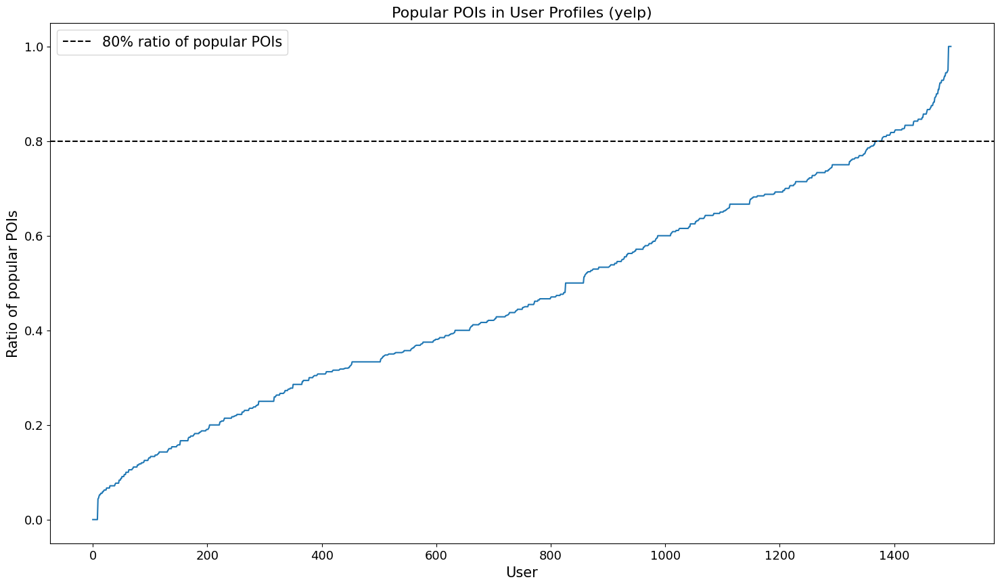

In [ ]:
# sorted_pop_fraq = sorted(pop_fraq)
# plt.figure(figsize=(18, 10))  # Adjust the figure size if needed
# plt.plot(sorted_pop_fraq, linestyle='-')
# plt.title(f'Popular POIs in User Profiles ({dataset})', fontsize=16)
# plt.xlabel('User', fontsize='15')
# plt.xticks(fontsize='13')
# plt.ylabel('Ratio of popular POIs', fontsize='15')
# plt.yticks(fontsize='13')
# plt.axhline(y=0.8, color='black', linestyle='--', label='80% ratio of popular POIs')
# plt.legend(fontsize='15')

# plt.savefig(f'{DATASET_DIR}/plots/Popular POIs in User Profiles ({dataset})', dpi=300)
# # plt.savefig('/Volumes/Forster Neu/Masterarbeit Data/snowcard/Popular POIs in User Profiles ({dataset})', dpi=300)


# plt.show()

R-value: 0.7347530839680058
P-value: 8.929854108299043e-255


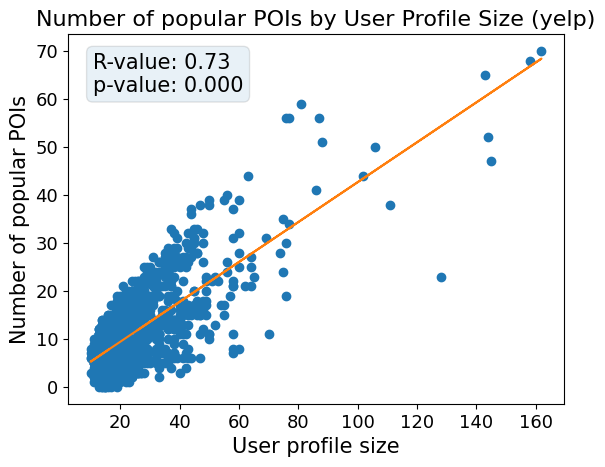

In [ ]:
plt.figure()
slope, intercept, r_value, p_value, std_err = stats.linregress(user_hist, pop_count)
print('R-value: ' + str(r_value))
print('P-value: ' + str(p_value))
line = slope * np.array(user_hist) + intercept
plt.plot(user_hist, pop_count, 'o', user_hist, line)
plt.title(f'Number of popular POIs by User Profile Size ({dataset})', fontsize=16) 
plt.xlabel('User profile size', fontsize='15')
plt.xticks(fontsize='13')
plt.ylabel('Number of popular POIs', fontsize='15')
plt.yticks(fontsize='13')

# Adding R-value and p-value to the plot
text_str = f'R-value: {r_value:.2f}\np-value: {p_value:.3f}'
plt.text(0.05, 0.95, text_str, transform=plt.gca().transAxes, fontsize=15,
         verticalalignment='top', bbox=dict(boxstyle='round', alpha=0.1))


plt.savefig(f'{DATASET_DIR}/plots/Number of popular POIs by User Profile Size ({dataset})', dpi=300)
# plt.savefig('/Volumes/Forster Neu/Masterarbeit Data/snowcard/Number of popular POIs by User Profile Size', dpi=300)


R-value: -0.068948014917014
SignificanceResult(statistic=-0.008109564377427676, pvalue=0.7536536500256388)


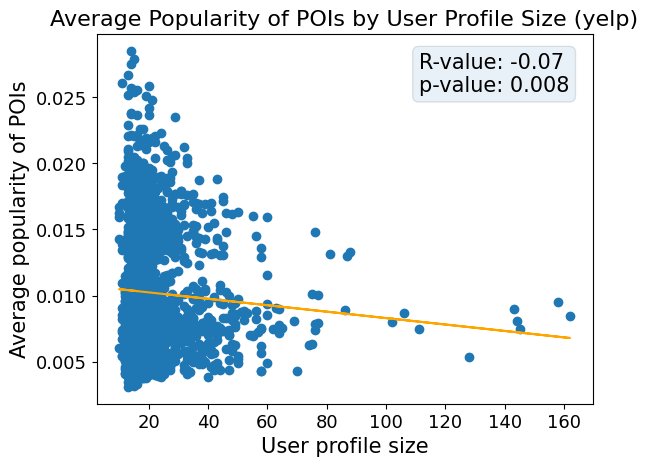

In [ ]:
# Create the figure
plt.figure()

# Perform linear regression
slope, intercept, r_value, p_value, std_err = stats.linregress(user_hist, pop_item_fraq)
print('R-value: ' + str(r_value))
print(stats.spearmanr(user_hist, pop_item_fraq))

# Create the line for the regression
line = slope * np.array(user_hist) + intercept

# Plot the data points and the regression line
plt.plot(user_hist, pop_item_fraq, 'o', label='Data Points')
plt.plot(user_hist, line, label='Regression Line', color='orange')

# Title and labels
plt.title(f'Average Popularity of POIs by User Profile Size ({dataset})', fontsize=16) 
plt.xlabel('User profile size', fontsize='15')
plt.ylabel('Average popularity of POIs', fontsize='15')
plt.xticks(fontsize='13')
plt.yticks(fontsize='13')

# Adding R-value and p-value to the plot
text_str = f'R-value: {r_value:.2f}\np-value: {p_value:.3f}'
plt.text(0.65, 0.95, text_str, transform=plt.gca().transAxes, fontsize=15,
         verticalalignment='top', bbox=dict(boxstyle='round', alpha=0.1))

# Save the plot
plt.savefig(f'{DATASET_DIR}/plots/Average Popularity of POIs by User Profile Size ({dataset})', dpi=300)

# Show the plot (optional)
plt.show()
